## Simple neural network models
*Tim Braams (8460701), Vinh Phan (8462380), Maximilian Pintilie (8462780), Rahul Singh (8464147), Kartik Vijay (8463465), Diego Zucchino (8345420)* 

In [1]:
import os
import pandas as pd

import optuna
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.model_selection import train_test_split

import scripts.ResultStore as rs
import scripts.FitPredict as fp
import scripts.ErrorAnalysis as ea

In [2]:
optuna.logging.set_verbosity(optuna.logging.WARNING)
pd.set_option("display.precision", 8)

#### Load data

In [3]:
train = pd.read_json("data/pooled_train_300.json")
test = pd.read_json("data/pooled_test_300.json")

In [4]:
train = train.loc[~(train==0).any(axis=1)]

In [5]:
y_train = train["returns"]
X_train = train.drop(["index", "asset", "returns", 
                     ], axis=1)

y_test = test["returns"]
X_test = test.drop(["index", "asset", "returns", 
                   ], axis=1)

#### Initialize a store for model results

In [6]:
results = rs.ResultStore(load_if_exists=True, path="results", name="results.json")

#### Baseline NN model: multi-layer peceptron
To start out we fit a simple MLP (100 neurons, one layer) with the scikit API. This will give us a baseline for how neural networks perform on the data. 

In [7]:
from sklearn.neural_network import MLPRegressor
mlp_model, mlp_predictions, mlp_results = fp.fit_predict(MLPRegressor(), 
                                                               X_fit=X_train, y_fit=y_train,
                                                               X_validate=X_test, y_validate=y_test, 
                                                               store=results)
results.get_df().sort_values("mse")

,model,predictions,truth,meta,mae,mse,train_mae,train_mse
3,XGBRegressor,"[0.0011180385, -0.0007129713000000001, -0.0002...","[0.0, 0.006618656200000001, -0.003158927, -0.0...","{'objective': 'reg:squarederror', 'base_score'...",0.00574853,0.00007566,0.00729701,0.00014180
2,XGBRegressor,"[0.0011033476, -0.00040828990000000003, 0.0003...","[0.0, 0.006618656200000001, -0.003158927, -0.0...","{'objective': 'reg:squarederror', 'base_score'...",0.00576150,0.00007602,0.00674717,0.00010793
1,LinearRegression,"[0.001156612, -0.0013134642000000001, 0.000941...","[0.0, 0.006618656200000001, -0.003158927, -0.0...","{'copy_X': True, 'fit_intercept': True, 'n_job...",0.00578076,0.00007618,0.00739078,0.00015420
0,DummyRegressor,"[0.0001602636, 0.0001602636, 0.0001602636, 0.0...","[0.0, 0.006618656200000001, -0.003158927, -0.0...","{'constant': None, 'quantile': None, 'strategy...",0.00580505,0.00007749,0.00744410,0.00015741
4,MLPRegressor,"[-0.0007679914215976552, -0.003377051288577279...","[0.0, 0.006618656200000001, -0.003158927, -0.0...","{'activation': 'relu', 'alpha': 0.0001, 'batch...",0.00607021,0.00007944,0.00757301,0.00014817


We see that the MLP is worse than all our previous models. It is not able to predict the test data well. The model is not able to caputre the relationships in the data, but in the predictions we can see that it does react to changes in data (does not predict a flat line). So if we increase the models capacity by adding more layers and nodes we can maybe improve model performance.

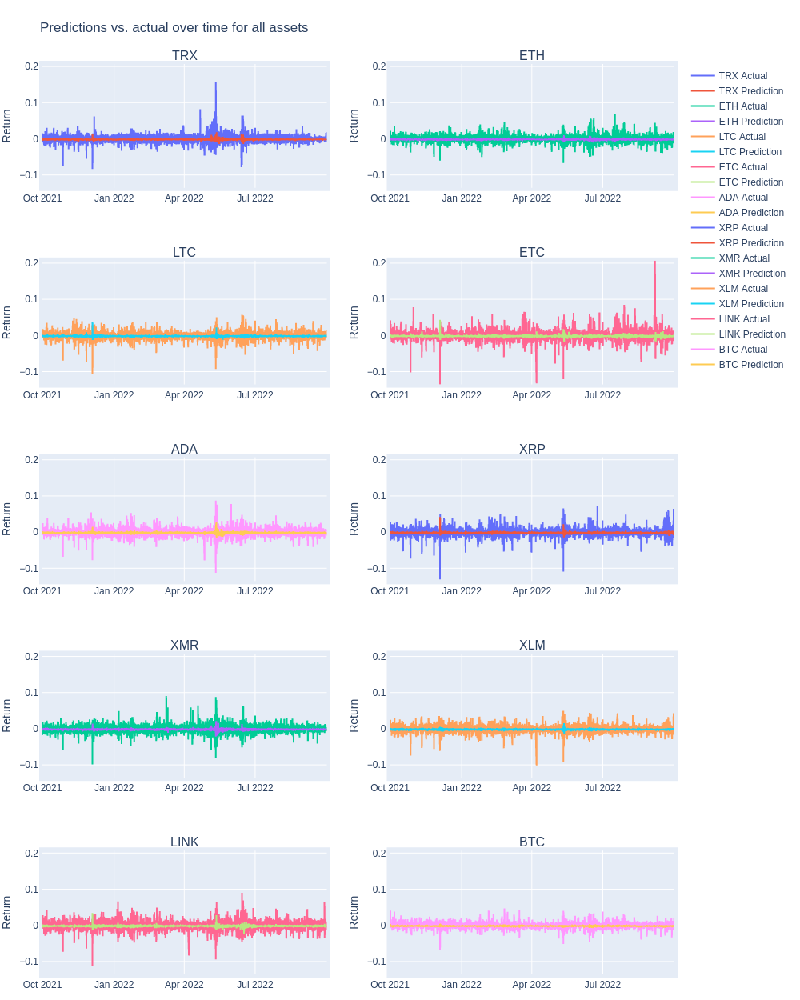

In [8]:
error_mlp = ea.ErrorAnalysis(y_true=y_test, y_pred=mlp_predictions, X=test, non_window_columns=["index", "returns", "asset"])
error_mlp.predictions().show(renderer="png")

#### Hyperparameter Optimization for MLP on subset of the data
As neural networks performance often mainly depends on how they are setup (i.e., how many layers, how many neurons) we run a hyperparamerter optimziation for the MLP. We only search for layers and neurons and keep all other settings the same (i.e., relu activation, adaptive LR, ...). Again we run on a subsample of the data to be able to try out more combinations.

In [9]:
subsample_train_x, valid_x, subsample_train_y, valid_y = train_test_split(X_train, y_train, test_size=0.5, random_state=42, shuffle=True)
subsample_train_x, subsample_valid_x, subsample_train_y, subsample_valid_y = train_test_split(subsample_train_x, subsample_train_y, test_size=0.3, random_state=42, shuffle=True)

In [10]:
def objective(trial):
    
    num_layers = trial.suggest_int("num_layers", 1, 4)
    layers = {1: trial.suggest_int("layer_1", 200, 500), 
              2: trial.suggest_int("layer_2", 200, 500), 
              3: trial.suggest_int("layer_3", 200, 500), 
              4: trial.suggest_int("layer_4", 200, 500)}
    hidden_layer_sizes = []
    for i in range(num_layers):
        hidden_layer_sizes.append(layers[i + 1])
    mlp_mod = MLPRegressor(hidden_layer_sizes=tuple(hidden_layer_sizes), 
                           learning_rate="adaptive", 
                           learning_rate_init=0.05, 
                           max_iter=500, early_stopping=True)
    
    mlp_mod.fit(subsample_train_x.values, subsample_train_y)
    preds = mlp_mod.predict(subsample_valid_x.values)
    mse = mean_squared_error(subsample_valid_y, preds)
    return mse

In [11]:
study = optuna.create_study(
    storage="sqlite:///results/db/mlpmodel_new.db", 
    load_if_exists=True,
    study_name="mlp2"
)

In [ ]:
# we do not run this cell here as it will take hours (it was run on a seperate server)
study.optimize(objective, n_trials=5000)

##### Retrieve best MLP model and fit it on the entire dataset
The best parameters for on the subsample of the data are used to fit the model on the entire dataset and predict on test data. Intrestingly the model does not perform better with more than 2 layers. It seems like  the first hidden layer is close to 300, which makes sense as the input layer also has 300 neurons.

In [12]:
study.best_params

{'layer_1': 284,
 'layer_2': 488,
 'layer_3': 328,
 'layer_4': 351,
 'num_layers': 2}

In [13]:
mlp_optuna = MLPRegressor(hidden_layer_sizes=(285, 485,), 
                           learning_rate="adaptive", 
                           learning_rate_init=0.05, 
                           max_iter=500, early_stopping=True)
mlp_optuna_model, mlp_optuna_predictions, mlp_optuna_results = fp.fit_predict(mlp_optuna, 
                                                               X_fit=X_train, y_fit=y_train,
                                                               X_validate=X_test, y_validate=y_test, 
                                                               store=results)

The model shows interesing results. All predictions on the test dataset are the same. Even with this, the model performs slightly better than without optimization. We definetly have to investigate what went wrong with this.

In [14]:
results.get_df().sort_values("mse")

,model,predictions,truth,meta,mae,mse,train_mae,train_mse
3,XGBRegressor,"[0.0011180385, -0.0007129713000000001, -0.0002...","[0.0, 0.006618656200000001, -0.003158927, -0.0...","{'objective': 'reg:squarederror', 'base_score'...",0.00574853,0.00007566,0.00729701,0.00014180
2,XGBRegressor,"[0.0011033476, -0.00040828990000000003, 0.0003...","[0.0, 0.006618656200000001, -0.003158927, -0.0...","{'objective': 'reg:squarederror', 'base_score'...",0.00576150,0.00007602,0.00674717,0.00010793
1,LinearRegression,"[0.001156612, -0.0013134642000000001, 0.000941...","[0.0, 0.006618656200000001, -0.003158927, -0.0...","{'copy_X': True, 'fit_intercept': True, 'n_job...",0.00578076,0.00007618,0.00739078,0.00015420
0,DummyRegressor,"[0.0001602636, 0.0001602636, 0.0001602636, 0.0...","[0.0, 0.006618656200000001, -0.003158927, -0.0...","{'constant': None, 'quantile': None, 'strategy...",0.00580505,0.00007749,0.00744410,0.00015741
5,MLPRegressor,"[0.00026359046196033865, 0.0002635904619603386...","[0.0, 0.006618656200000001, -0.003158927, -0.0...","{'activation': 'relu', 'alpha': 0.0001, 'batch...",0.00580983,0.00007754,0.00745579,0.00018314
4,MLPRegressor,"[-0.0007679914215976552, -0.003377051288577279...","[0.0, 0.006618656200000001, -0.003158927, -0.0...","{'activation': 'relu', 'alpha': 0.0001, 'batch...",0.00607021,0.00007944,0.00757301,0.00014817


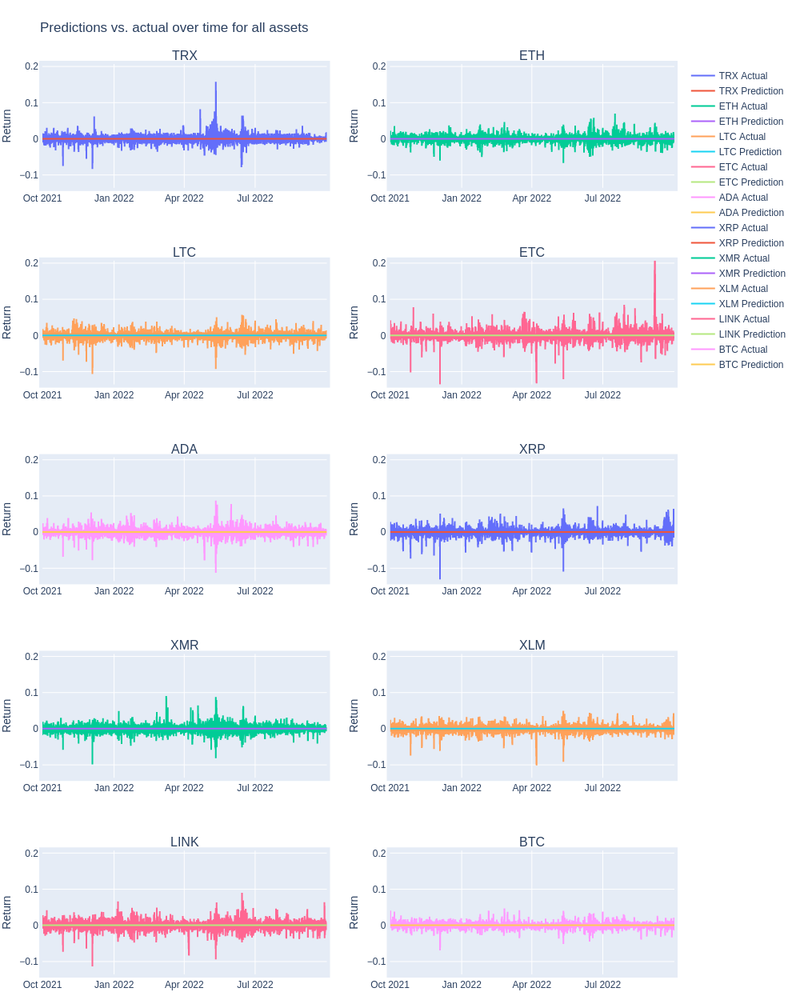

In [15]:
error_mlp_optuna = ea.ErrorAnalysis(y_true=y_test, y_pred=mlp_optuna_predictions, X=test, non_window_columns=["index", "returns", "asset"])
error_mlp_optuna.predictions().show(renderer="png")

As something went wrong with the model above we refit it on the subsampled data and predict on the validation data again.

In [16]:
mlp_optuna_subset = MLPRegressor(hidden_layer_sizes=(285, 485,), 
                           learning_rate="adaptive", 
                           learning_rate_init=0.05, 
                           max_iter=500, early_stopping=True)
mlp_optuna_subset.fit(subsample_train_x.values, subsample_train_y)
preds = mlp_optuna_subset.predict(subsample_valid_x.values)

The model shows the same behaivor when fitted on the subset. Probably the parameters are not choosen well. We reduce the complexity of the model by reducing the number of neurons and layers.

In [17]:
preds

array([0.00023785, 0.00023785, 0.00023785, ..., 0.00023785, 0.00023785,
       0.00023785])

In [18]:
mlp_optuna = MLPRegressor(hidden_layer_sizes=(350,), 
                           learning_rate="adaptive", 
                           learning_rate_init=0.05, 
                           max_iter=500, early_stopping=True)
mlp_optuna_model, mlp_optuna_predictions, mlp_optuna_results = fp.fit_predict(mlp_optuna, 
                                                               X_fit=X_train, y_fit=y_train,
                                                               X_validate=X_test, y_validate=y_test, 
                                                               store=results
                                                                             )
error_mlp_optuna = ea.ErrorAnalysis(y_true=y_test, y_pred=mlp_optuna_predictions, X=test, non_window_columns=["index", "returns", "asset"])

As expected the results now look different. The MLP now predicts "more sensible" and seems to have actually learned something, as it outperforms the other MLP models. This is an important learning, that you cannot just use automatic hyperparameter tuning for everything, without taking care that the model predicts something useful. In this case the model is not able to outperform our more simple statistical models.

In [19]:
results.get_df().sort_values("mse")

,model,predictions,truth,meta,mae,mse,train_mae,train_mse
3,XGBRegressor,"[0.0011180385, -0.0007129713000000001, -0.0002...","[0.0, 0.006618656200000001, -0.003158927, -0.0...","{'objective': 'reg:squarederror', 'base_score'...",0.00574853,0.00007566,0.00729701,0.00014180
2,XGBRegressor,"[0.0011033476, -0.00040828990000000003, 0.0003...","[0.0, 0.006618656200000001, -0.003158927, -0.0...","{'objective': 'reg:squarederror', 'base_score'...",0.00576150,0.00007602,0.00674717,0.00010793
1,LinearRegression,"[0.001156612, -0.0013134642000000001, 0.000941...","[0.0, 0.006618656200000001, -0.003158927, -0.0...","{'copy_X': True, 'fit_intercept': True, 'n_job...",0.00578076,0.00007618,0.00739078,0.00015420
6,MLPRegressor,"[0.002141865665353566, 2.7644433020144327e-05,...","[0.0, 0.006618656200000001, -0.003158927, -0.0...","{'activation': 'relu', 'alpha': 0.0001, 'batch...",0.00583368,0.00007727,0.00745294,0.00015638
0,DummyRegressor,"[0.0001602636, 0.0001602636, 0.0001602636, 0.0...","[0.0, 0.006618656200000001, -0.003158927, -0.0...","{'constant': None, 'quantile': None, 'strategy...",0.00580505,0.00007749,0.00744410,0.00015741
5,MLPRegressor,"[0.00026359046196033865, 0.0002635904619603386...","[0.0, 0.006618656200000001, -0.003158927, -0.0...","{'activation': 'relu', 'alpha': 0.0001, 'batch...",0.00580983,0.00007754,0.00745579,0.00018314
4,MLPRegressor,"[-0.0007679914215976552, -0.003377051288577279...","[0.0, 0.006618656200000001, -0.003158927, -0.0...","{'activation': 'relu', 'alpha': 0.0001, 'batch...",0.00607021,0.00007944,0.00757301,0.00014817


Interestingly, the model seems to predict with very little variation. It does not have any outliers, and regardless of how the series moves it does not show any variation in the predictions. It basically is a more advanced dummy predictor. From a visual standpoint the predictions look like noise and, even though worse scores in total, the predictions of the default model look more reasonable as it reacts to spikes in the data. With further investigation into this model it probably could perform better.

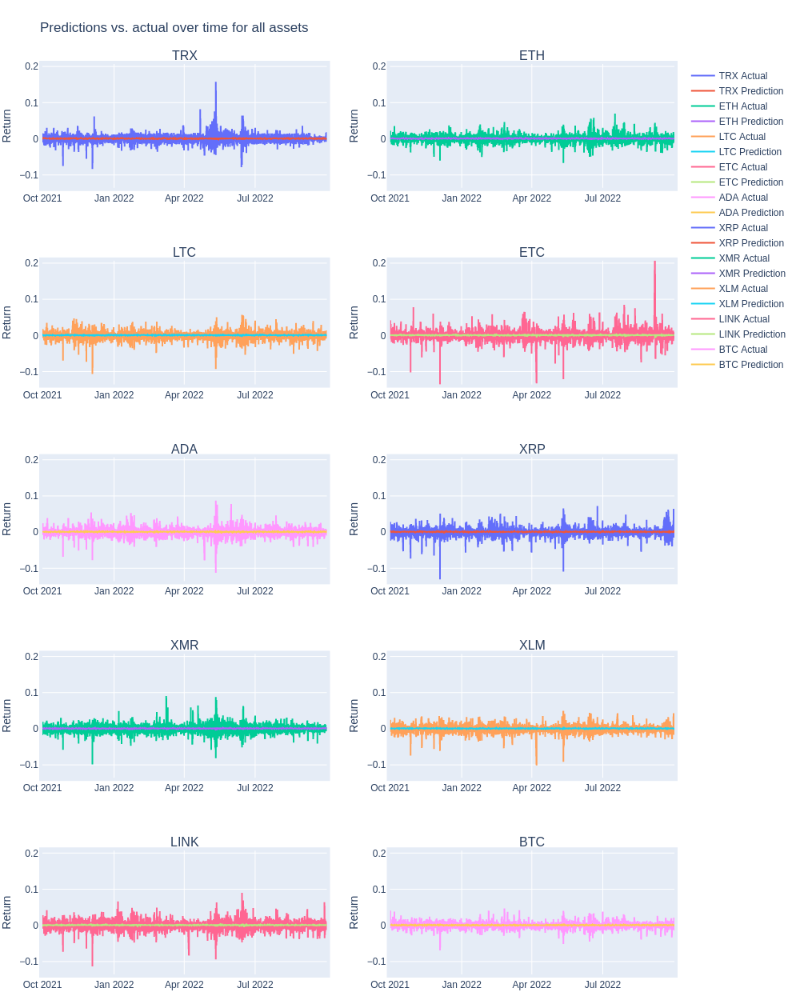

In [20]:
error_mlp_optuna.predictions().show(renderer="png")

Out of all tested models this model has the lowest correlation between the standard deviation in the window and the prediction error. Again the error is very symetrical and is consitent with other models. It still seems like the model is not actually learning relationships in the data. 

-------------------- Error report --------------------
Correlation of window standard deviation and error 0.09758450490280501                     
asset               ADA         BTC         ETC         ETH        LINK  \
correlation  0.13283226  0.08923260  0.03222909  0.13096280  0.11869508   
MSE          0.00008184  0.00003859  0.00012407  0.00006321  0.00010219   
MAE          0.00614523  0.00417328  0.00705681  0.00545341  0.00705525   
mean        -0.00014064 -0.00007345  0.00000183 -0.00006210 -0.00007971   
std          0.00905281  0.00619942  0.01118492  0.00796992  0.01013135   

asset               LTC         TRX         XLM         XMR         XRP  
correlation  0.09814524  0.11670492  0.07987051  0.14850994  0.08002236  
MSE          0.00007251  0.00006584  0.00006604  0.00008323  0.00007523  
MAE          0.00574475  0.00494474  0.00572645  0.00638767  0.00565231  
mean        -0.00008453 -0.00001097 -0.00006963 -0.00002010 -0.00004157  
std          0.00853162  0.00811

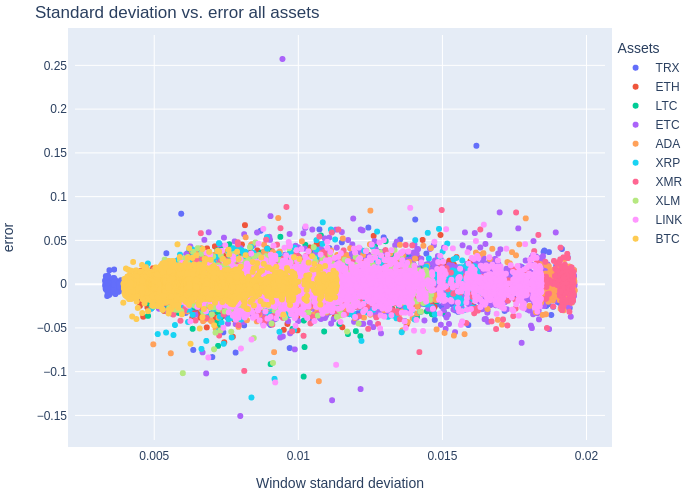

 
-------------------- Error over time per asset --------------------


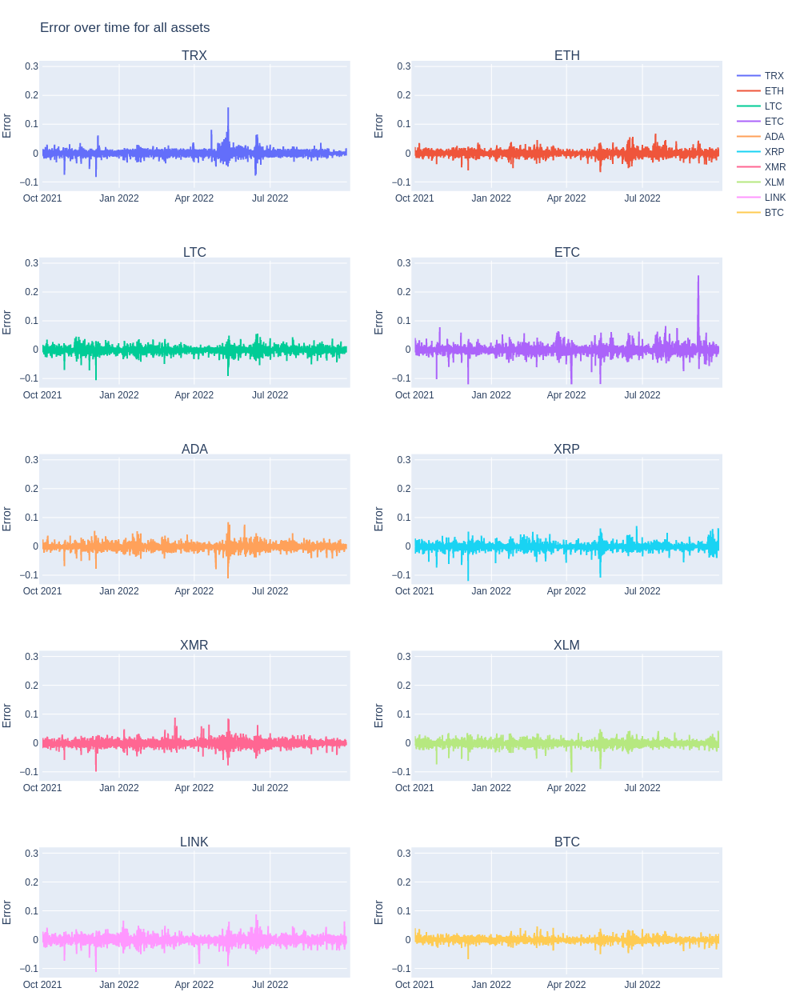

In [21]:
error_mlp_optuna.report()

#### Simple one layer LSTM
Next we use a more advanced approach: LSTMs are widley used in time series predictions as they are able to "memorize" long term data trends and understand the data as a series of values more than indivudual features (compared to a MLP).  
  
We wanted to use LSTM models as they build upon RNN, which are Neural Networks for time series that use a sliding window of data at a time and work such that they carry information from the past into the presence. Drawbacks of basic RNNs are that they can have vanishing or eploding gradients due to sigmoid and matrix multiplications done  often and also that they forget passt information due to repeated concatenation of new data and then transforming the concatinated vector (1, p. 2). The LSTM introduces more "gates" that resolve the issue of only having "short term" memory, speifically the introduction of cell state as memory that is updated conditionally on what part of the current cell state is to be remembered and what is to be forgotten (1, p. 3). LSTM's advantage over simple RNNs is the ability to decide what to remember and what not to remember (1, p. 4), giving the model greater ability to remember information from the distant past that is relevant to the present.  
  
1) Chung, J., Gulcehre, C., Cho, K., & Bengio, Y. (2014). Empirical evaluation of gated recurrent neural networks on sequence modeling. 
In NIPS 2014 Workshop on Deep Learning, December 2014  
  
For more motivation on why LSTMs make sense for our usecase, have a look at our cutting edge models.
We start of with a simple one layer LSTM and look at the results to determine if its promissing. 

In [22]:
import os
os.environ["PROTOCOL_BUFFERS_PYTHON_IMPLEMENTATION"] = "python"

from tensorflow.keras.callbacks import ModelCheckpoint, ReduceLROnPlateau, EarlyStopping
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
from tensorflow.keras.optimizers import Adam

2022-11-17 21:10:06.245211: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2022-11-17 21:10:06.245231: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.


For this model we use a seperate validation dataset to calculate a validation loss during training, allowing us to early stop and reduce the learning rate during training, based on training success.

In [23]:
train_subset, val_subset = train_test_split(train.sort_values(by='index'), test_size=0.2, random_state=42, shuffle=False)

In [24]:
# reverse column order (oldest first, newest last)
train_subset = train_subset[train_subset.columns[::-1]]
val_subset = val_subset[val_subset.columns[::-1]]
X_test_reverse = X_test[X_test.columns[::-1]]

y_train_subset = train_subset["returns"]
X_train_subset = train_subset.drop(["index", "asset", "returns", 
                     ], axis=1)

y_val = val_subset["returns"]
x_val = val_subset.drop(["index", "asset", "returns", 
                     ], axis=1)

We reshape the data to have vectors that we feed into the LSTM instead of using a dataframe like before.

In [25]:
X_train_lstm = X_train_subset.to_numpy().reshape(X_train_subset.shape[0],X_train_subset.shape[1],1)
y_train_lstm = y_train_subset.to_numpy().reshape(y_train_subset.shape[0],1)
X_test_lstm = X_test_reverse.to_numpy().reshape(X_test_reverse.shape[0],X_test_reverse.shape[1],1)
y_test_lstm = y_test.to_numpy().reshape(y_test.shape[0],1)
X_val_train_lstm = x_val.to_numpy().reshape(x_val.shape[0],x_val.shape[1],1)
y_val_train_lstm = y_val.to_numpy().reshape(y_val.shape[0],1)

First we add a normalization layer as this helps LSTMs with convergance and prediction performance. We naively choose a size of 300 hidden units, as this is our size of input data. In a future step we will tune this parameter.

In [26]:
model = Sequential()
model.add(layers.Normalization())
model.add(layers.LSTM(300, input_shape=(X_train_lstm.shape[1], 1), name='input_layer'))
model.add(layers.Dense(units = 1))

2022-11-17 21:10:07.757023: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory
2022-11-17 21:10:07.757047: W tensorflow/stream_executor/cuda/cuda_driver.cc:269] failed call to cuInit: UNKNOWN ERROR (303)
2022-11-17 21:10:07.757062: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (Ubuntu-1804-bionic-64-minimal): /proc/driver/nvidia/version does not exist
2022-11-17 21:10:07.757511: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


We add early stopping and ReduceLROnPlateau, which reduces the LR by a factor of 0.2 when val loss is not improving for 5 epochs to a minimum of 0.0001. This allows us to choose a higher initial LR and then eventually fine-tuning when the model does not impove for a while.

In [27]:
checkpoint_filepath = "temp/one_layer_lstm/checkpoint.ckpt"
model_checkpoint_callback = ModelCheckpoint(
    filepath=checkpoint_filepath,
    save_weights_only=True,
    monitor='val_loss',
    mode='min',
    save_best_only=True)

callback = EarlyStopping(monitor='val_loss', patience=8)

reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.2,
                              patience=5, min_lr=0.0001)

Compile and fit the model with MSE as its loss. The model will fit for a maximum of 50 epochs. 

In [28]:
model.compile(loss='mean_squared_error', optimizer='adam', metrics = ['mse'])

In [ ]:
# model was trained on different server, therefore just loading weights
history = model.fit(x=X_train_lstm, y=y_train_lstm, 
          batch_size=128, epochs=50, 
          validation_data=(X_val_train_lstm, y_val_train_lstm), 
          callbacks=[callback, reduce_lr, model_checkpoint_callback])

From plotting the models train and validation MSE it becomes clear that the model does not learn much during training. The scores do not improve during training.  
*The following cell will not run without the above cell being converted to a code cell.*

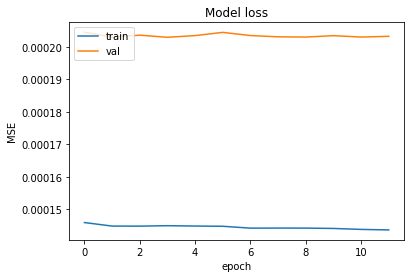

In [39]:
from matplotlib import pyplot as plt
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('MSE')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

Load the best saved weights.

In [29]:
model.load_weights(checkpoint_filepath)

Predict on all the datasets.

In [30]:
y_pred_test = model.predict(X_test_lstm)
y_pred_train = model.predict(X_train_lstm)
y_pred_val = model.predict(X_val_train_lstm)

2032/2032 [==============================] - 190s 93ms/step


Calculate the scores.

In [31]:
mae = mean_absolute_error(y_test_lstm, y_pred_test)
mse = mean_squared_error(y_test_lstm, y_pred_test)
mae_train = mean_absolute_error(y_train_lstm, y_pred_train)
mse_train = mean_squared_error(y_train_lstm, y_pred_train)
mae_val = mean_absolute_error(y_val_train_lstm, y_pred_val)
mse_val = mean_squared_error(y_val_train_lstm, y_pred_val)
scores = {"mae": mae, "mse": mse, "train_mae": mae_train, "train_mse": mse_train, "val_mae": mae_val, "val_mse": mse_val}

We can observe that the LSTM (here named Sequential) is outperforming our MLP model but still performs worse than the more simple linear regression and XGBoost models.

In [32]:
results.add(model, scores, list(y_pred_test.reshape(1, -1))[0], list(y_test_lstm.reshape(1, -1))[0], "LSTM")
results.get_df().sort_values("mse")

,model,predictions,truth,meta,mae,mse,train_mae,train_mse,val_mae,val_mse
3,XGBRegressor,"[0.0011180385, -0.0007129713000000001, -0.0002...","[0.0, 0.006618656200000001, -0.003158927, -0.0...","{'objective': 'reg:squarederror', 'base_score'...",0.00574853,0.00007566,0.00729701,0.00014180,NaN,NaN
2,XGBRegressor,"[0.0011033476, -0.00040828990000000003, 0.0003...","[0.0, 0.006618656200000001, -0.003158927, -0.0...","{'objective': 'reg:squarederror', 'base_score'...",0.00576150,0.00007602,0.00674717,0.00010793,NaN,NaN
1,LinearRegression,"[0.001156612, -0.0013134642000000001, 0.000941...","[0.0, 0.006618656200000001, -0.003158927, -0.0...","{'copy_X': True, 'fit_intercept': True, 'n_job...",0.00578076,0.00007618,0.00739078,0.00015420,NaN,NaN
7,Sequential,"[0.0013787175, -0.00069354346, 0.0001870371, -...","[0.0, 0.006618656200000001, -0.003158927, -0.0...",LSTM,0.00577232,0.00007635,0.00698606,0.00014350,0.00903255,0.00020311
6,MLPRegressor,"[0.002141865665353566, 2.7644433020144327e-05,...","[0.0, 0.006618656200000001, -0.003158927, -0.0...","{'activation': 'relu', 'alpha': 0.0001, 'batch...",0.00583368,0.00007727,0.00745294,0.00015638,NaN,NaN
0,DummyRegressor,"[0.0001602636, 0.0001602636, 0.0001602636, 0.0...","[0.0, 0.006618656200000001, -0.003158927, -0.0...","{'constant': None, 'quantile': None, 'strategy...",0.00580505,0.00007749,0.00744410,0.00015741,NaN,NaN
5,MLPRegressor,"[0.00026359046196033865, 0.0002635904619603386...","[0.0, 0.006618656200000001, -0.003158927, -0.0...","{'activation': 'relu', 'alpha': 0.0001, 'batch...",0.00580983,0.00007754,0.00745579,0.00018314,NaN,NaN
4,MLPRegressor,"[-0.0007679914215976552, -0.003377051288577279...","[0.0, 0.006618656200000001, -0.003158927, -0.0...","{'activation': 'relu', 'alpha': 0.0001, 'batch...",0.00607021,0.00007944,0.00757301,0.00014817,NaN,NaN


In [33]:
error_lstm = ea.ErrorAnalysis(y_true=y_test, y_pred=list(y_pred_test.reshape(1, -1))[0], 
                              X=test, non_window_columns=["index", "asset", "returns"])

Plotting the predictions vs. the actual values reveals that in comparison to the MLP the model does is predicting less in a flat line and with more variation. Still the model does not handle extrem cases and is not really fitting the data well.

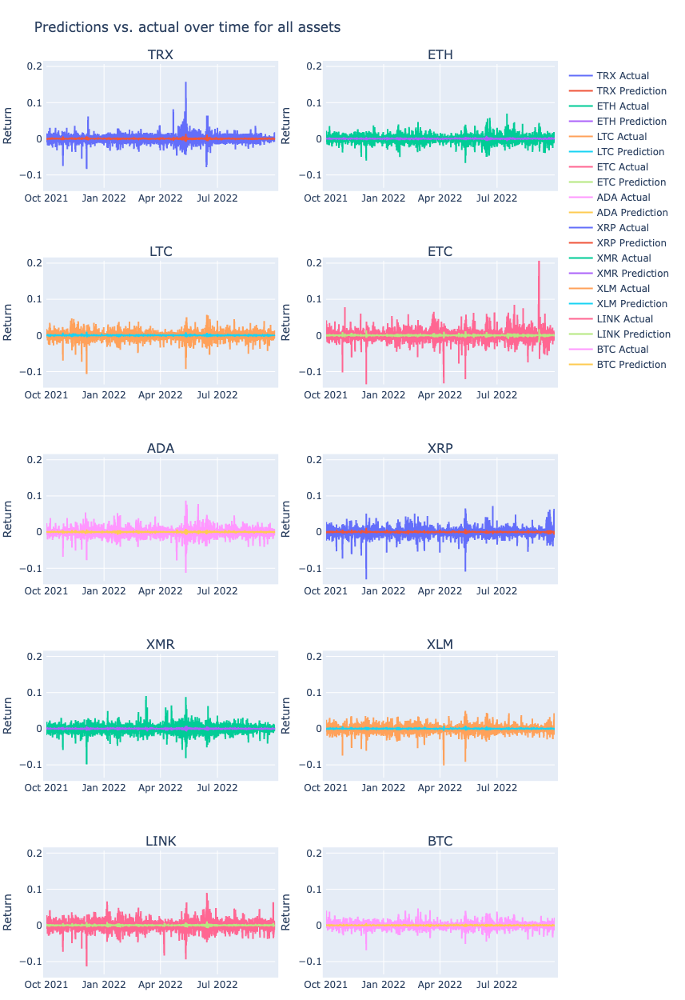

In [34]:
error_lstm.predictions()

The LSTM also has a slightly lower correlation than most models, meaning it is better at predicting even if there is high volatility. Increasing the model complexity further might improve this behaivior. For this one could use a stacked LSTM.

-------------------- Error report --------------------
Correlation of window standard deviation and error 0.09791214750391883                     
asset               ADA         BTC         ETC         ETH        LINK  \
correlation  0.13342491  0.08904394  0.03208624  0.12976072  0.12039784   
MSE          0.00008060  0.00003763  0.00012251  0.00006207  0.00010087   
MAE          0.00607918  0.00408936  0.00697218  0.00537773  0.00700359   
mean        -0.00014064 -0.00007345  0.00000183 -0.00006210 -0.00007971   
std          0.00905281  0.00619942  0.01118492  0.00796992  0.01013135   

asset               LTC         TRX         XLM         XMR         XRP  
correlation  0.10097182  0.11877544  0.08163720  0.14993694  0.08038345  
MSE          0.00007185  0.00006514  0.00006559  0.00008253  0.00007477  
MAE          0.00569305  0.00482765  0.00570390  0.00636024  0.00561997  
mean        -0.00008453 -0.00001097 -0.00006963 -0.00002010 -0.00004157  
std          0.00853162  0.00811

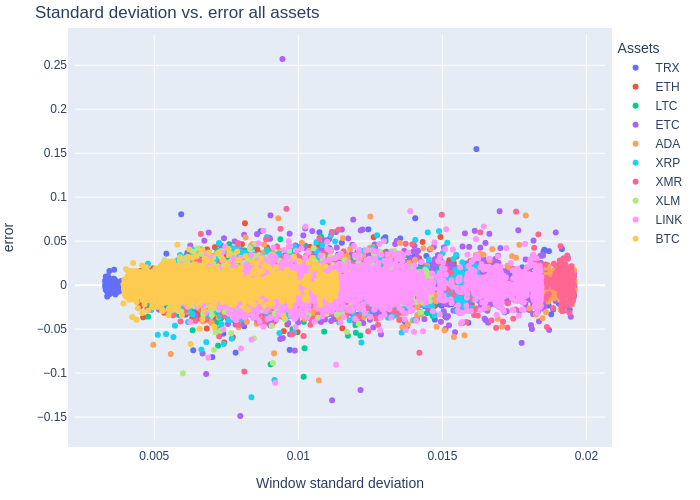

 
-------------------- Error over time per asset --------------------


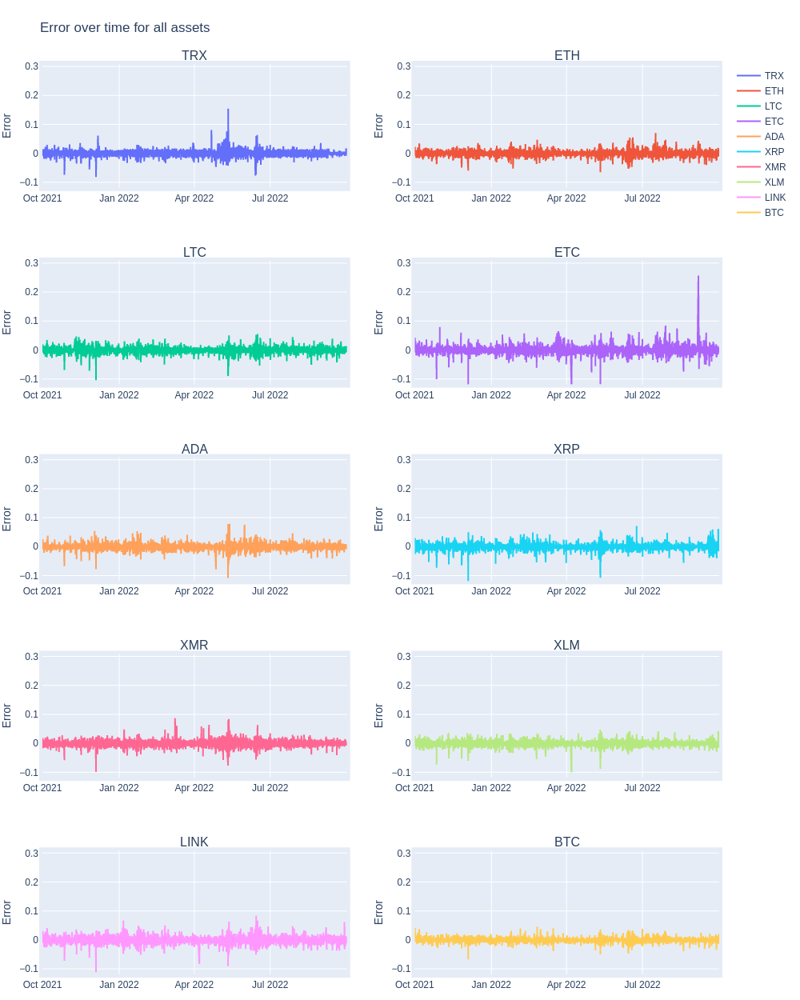

In [35]:
error_lstm.report()

In [36]:
results.save(path="results", name="02_results.json")